# EDA

## 概要

* 分析に先駆けたEDA用のノートブックです。
* 適当にいろいろデータの特徴を見ていきます。

## 分かったこと

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import polars as pl
import seaborn as sns
from plotly.offline import init_notebook_mode

init_notebook_mode(connected=True)

pd.set_option("display.max_columns", None)
pd.set_option("display.max_colwidth", None)
pd.set_option("display.max_rows", 50)
pl.Config.set_tbl_cols(999)
pl.Config.set_tbl_rows(30)

# plt.style.use("ggplot")
sns.set()
plt.rcParams["font.family"] = ["Noto Sans JP"]
plt.rcParams["mathtext.fontset"] = "cm"
# plt.rcParams["font.size"] = 10.5

%matplotlib inline
%config InlineBackend.figure_format = "retina"

In [2]:
df_anime = pd.read_csv("../data/anime.csv")
df_anime

,anime_id,genres,japanese_name,type,episodes,aired,producers,licensors,studios,source,duration,rating,members,watching,completed,on_hold,dropped,plan_to_watch
0,000ba7f7e34e107e7544,"Comedy, Sci-Fi, Seinen, Slice of Life, Space",宇宙兄弟,TV,99,"Apr 1, 2012 to Mar 22, 2014","Aniplex, Dentsu, YTV, Trinity Sound",Sentai Filmworks,A-1 Pictures,Manga,24 min. per ep.,PG-13 - Teens 13 or older,150428,16552,37234,13009,6948,76685
1,00427279d72064e7fb69,"Adventure, Slice of Life, Mystery, Historical, Supernatural, Fantasy, Seinen",蟲師,TV,26,"Oct 23, 2005 to Jun 19, 2006","Avex Entertainment, Marvelous, SKY Perfect Well Think, Delfi Sound",Funimation,Artland,Manga,25 min. per ep.,PG-13 - Teens 13 or older,620736,55482,235371,42786,20017,267080
2,00444b67aaabdf740a68,"Adventure, Slice of Life, Mystery, Historical, Supernatural, Fantasy, Seinen",蟲師 続章,TV,10,"Apr 5, 2014 to Jun 21, 2014","Aniplex, Kodansha, Delfi Sound",Aniplex of America,Artland,Manga,24 min. per ep.,PG-13 - Teens 13 or older,226522,12585,113559,6095,2606,91677
3,00839a3507ab168abe75,"Comedy, Ecchi, Fantasy, School",星刻の竜騎士,TV,12,"Apr 5, 2014 to Jun 21, 2014","Media Factory, AT-X, Sony Music Communications, Tsukuru no Mori",Funimation,C-Station,Light novel,24 min. per ep.,R+ - Mild Nudity,170220,8723,118202,3753,8034,31508
4,0192331235e110fe4f76,"Comedy, Harem, Romance, Sci-Fi, Shounen, Space",天地無用！,TV,26,"Apr 2, 1995 to Sep 24, 1995","TV Tokyo, Pioneer LDC","Funimation, Geneon Entertainment USA",AIC,Original,23 min. per ep.,PG-13 - Teens 13 or older,62599,2565,39890,2093,1986,16065
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,ff73475b68001c5e533d,"Adventure, Romance, Mecha, Military, Sci-Fi, Horror, Space, Drama",BLUE GENDER,TV,26,"Oct 8, 1999 to Mar 31, 2000","Youmex, Toshiba EMI",Funimation,AIC,Original,23 min. per ep.,R+ - Mild Nudity,65360,2738,31583,2534,3195,25310
1996,ff8611bae4e43862381f,"Ecchi, Romance, School",フォトカノ,TV,13,"Apr 5, 2013 to Jun 28, 2013","TBS, Enterbrain, BS-TBS, RAY",Sentai Filmworks,Madhouse,Visual novel,23 min. per ep.,PG-13 - Teens 13 or older,93558,6242,45399,3415,8680,29822
1997,ffa143ffd4abec9d2707,"Action, Fantasy, Military, Sci-Fi",GOD EATER,TV,13,"Jul 12, 2015 to Mar 26, 2016","Bandai Visual, Lantis, Anime Consortium Japan",Aniplex of America,ufotable,Game,23 min. per ep.,R - 17+ (violence & profanity),426616,35000,242285,16731,31573,101027
1998,ffb4819df40db39facfa,"Action, Adventure, Fantasy, School, Sci-Fi",鋼殻のレギオス,TV,24,"Jan 11, 2009 to Jun 21, 2009",AMG MUSIC,Funimation,Zexcs,Light novel,24 min. per ep.,R - 17+ (violence & profanity),178908,9139,118689,5611,6544,38925


In [3]:
df_train = pd.read_csv("../data/train.csv")
df_test = pd.read_csv("../data/test.csv")

In [4]:
df_train.merge(df_test, on="user_id", how="outer", indicator=True)._merge.value_counts()

both          12004642
right_only       26754
left_only           56
Name: _merge, dtype: int64

In [5]:
df_train.merge(df_test, on="user_id", how="outer", indicator=True).query(
    "_merge == 'right_only'"
).user_id.value_counts()

99397dc9659e76297ac9    482
fa532dafc50ad8439e1d    448
dcf815e240443e311c0f    424
307145f76a85c96cdf9c    420
176a0af2b36120834613    413
                       ... 
a7d888875765e2d4f653      4
1fccc0facc762d4eb2a6      4
68d73a98d04902bdcfd1      4
e730694d5cb9752ec8b5      3
fd64597be5e54f4ac9d3      1
Name: user_id, Length: 204, dtype: int64

In [6]:
df_train.merge(
    df_test, on="anime_id", how="outer", indicator=True
)._merge.value_counts()

both          17549236
left_only            2
right_only           2
Name: _merge, dtype: int64

なんとなくかぶってそう。

In [7]:
(
    df_test.merge(
        df_train.groupby("anime_id")
        .agg(mean_anime_score=("score", "mean"), train_count=("user_id", "nunique"))
        .reset_index(),
        on="anime_id",
        how="left",
    ).merge(
        df_train.groupby("user_id")
        .agg(mean_user_score=("score", "mean"), train_anime_num=("anime_id", "nunique"))
        .reset_index(),
        on="user_id",
        how="left",
    )
).query("mean_anime_score.isna() & mean_user_score.isna()")

,user_id,anime_id,mean_anime_score,train_count,mean_user_score,train_anime_num
26139,332a8a7544b04e35b059,d7cee297224130410c3b,NaN,NaN,NaN,NaN


* testにしかいないuserの場合
    * animeの平均スコアなどを使うしかない。
    * userの追加情報はなし
* testにしかないanimeの場合
    * 外部のanime情報からanimeの平均スコアを推定することができそう。
    * このanime平均スコアに対して、userごとのスコア傾向を考慮して付与する
* testにしかanimeもuserもない場合
    * 全体の平均を使う以外の方法ない

階層ベイズを使う？

animeの平均スコア予測モデルは別につくる？

## データの整備

In [8]:
def hook_user(df_train, df_test):
    df_user = pd.DataFrame({"user_id": pd.concat([df_train, df_test]).user_id.unique()})
    df_train_agg = (
        df_train.groupby("user_id")
        .agg(mean_score=("score", "mean"), train_anime_num=("anime_id", "nunique"))
        .reset_index()
    )
    df_test_agg = (
        df_test.groupby("user_id")
        .agg(test_anime_num=("anime_id", "nunique"))
        .reset_index()
    )

    df_user = df_user.merge(df_train_agg, on="user_id", how="left").merge(
        df_test_agg, on="user_id", how="left"
    )
    return df_user


df_user = hook_user(df_train, df_test)
df_user

,user_id,mean_score,train_anime_num,test_anime_num
0,0008e10fb39e55447333,6.951220,41.0,27.0
1,001a7aed2546342e2602,7.512500,160.0,122.0
2,003d4b0257cc7849ffe1,8.000000,35.0,24.0
3,0054e700b5be6e074fb7,8.166667,6.0,5.0
4,0059344eed7e8ca0b6c5,7.600000,10.0,7.0
...,...,...,...,...
1993,fa11453a6cca09c82953,NaN,NaN,29.0
1994,fa532dafc50ad8439e1d,NaN,NaN,448.0
1995,fcf79144bf18fdb90aa5,NaN,NaN,51.0
1996,fd64597be5e54f4ac9d3,NaN,NaN,1.0


In [9]:
def hook_anime(df_anime, df_train, df_test):
    df_train_agg = (
        df_train.groupby("anime_id")
        .agg(mean_score=("score", "mean"), train_user_num=("user_id", "nunique"))
        .reset_index()
    )
    df_test_agg = (
        df_test.groupby("anime_id")
        .agg(test_user_num=("user_id", "nunique"))
        .reset_index()
    )

    df_anime = df_anime.merge(df_train_agg, on="anime_id", how="left").merge(
        df_test_agg, on="anime_id", how="left"
    )
    # 期間をはじめと終わりの2つのカラムに分割
    df_anime = df_anime.join(
        df_anime["aired"]
        .str.split(" to ", expand=True)
        .rename(columns={0: "start", 1: "end"})
        .replace({"Unknown": None, "?": None})
        .assign(
            start=lambda df: pd.to_datetime(df["start"]),
            end=lambda df: pd.to_datetime(df["end"]),
        )
    )
    # genresを分割して縦持ちに(UNNEST CORSS JOIN)
    df_anime = df_anime.drop(columns=["genres"]).join(
        df_anime["genres"].str.split(",").explode()
    )
    return df_anime


df_summary = hook_anime(df_anime, df_train, df_test)

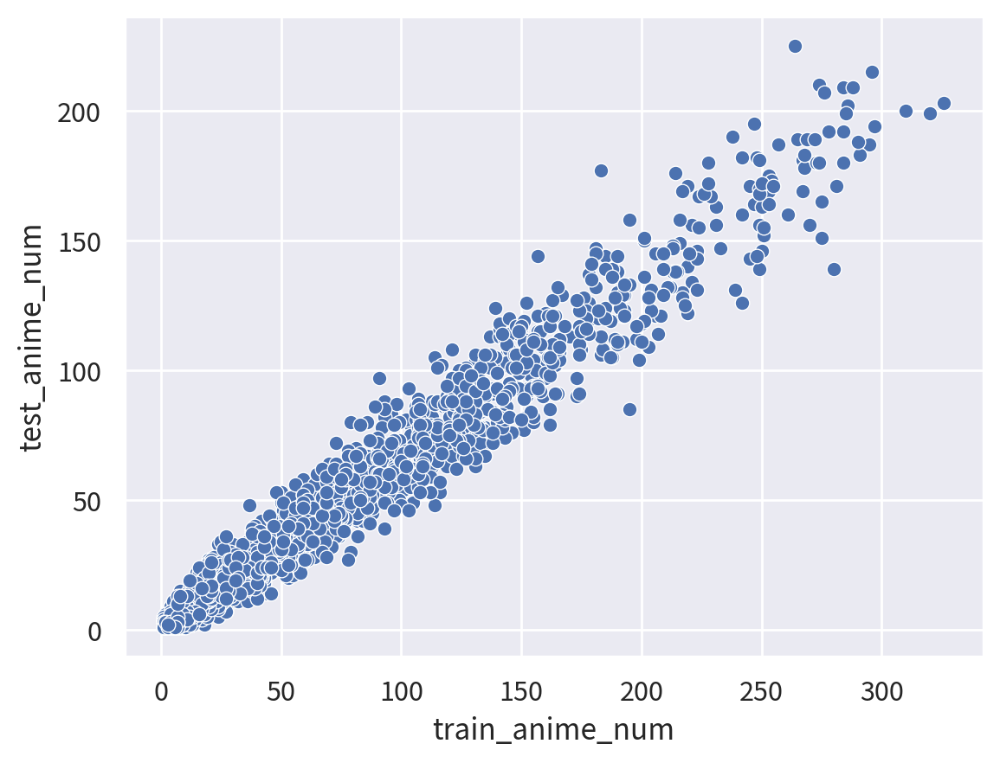

In [10]:
sns.scatterplot(data=df_user, x="train_anime_num", y="test_anime_num")
plt.show()

In [11]:
px.box(df_summary, x="genres", y="mean_score")

In [12]:
px.box(df_summary.merge(df_train, on="anime_id"), x="genres", y="score")

In [13]:
px.line(
    df_summary.groupby("start").agg(mean_score=("mean_score", "mean")).reset_index(),
    x="start",
    y="mean_score",
)

<Axes: xlabel='score', ylabel='Probability'>

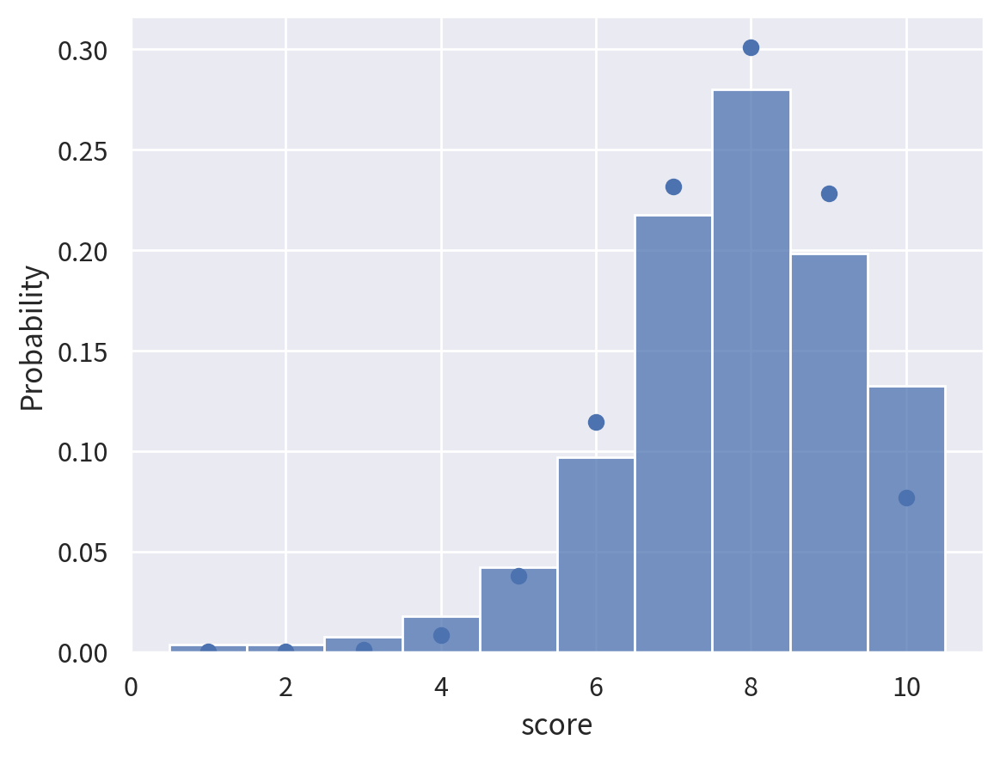

In [14]:
import scipy.stats as st

fig, ax = plt.subplots()

k = np.arange(10)
p = (df_train.score - 1).mean() / 9
binom_pmf = st.binom.pmf(k=k, n=9, p=p)

ax.plot(k + 1, binom_pmf, "o")
sns.histplot(x=df_train.score, stat="probability", discrete=True, ax=ax)

得点の分布はほとんど、2項分布の理論値とそこまでかわらない。

### idの重複状況調査

In [18]:
df_summary

,anime_id,japanese_name,type,episodes,aired,producers,licensors,studios,source,duration,rating,members,watching,completed,on_hold,dropped,plan_to_watch,mean_score,train_user_num,test_user_num,start,end,genres
0,000ba7f7e34e107e7544,宇宙兄弟,TV,99,"Apr 1, 2012 to Mar 22, 2014","Aniplex, Dentsu, YTV, Trinity Sound",Sentai Filmworks,A-1 Pictures,Manga,24 min. per ep.,PG-13 - Teens 13 or older,150428,16552,37234,13009,6948,76685,8.529412,17.0,15.0,2012-04-01,2014-03-22,Comedy
0,000ba7f7e34e107e7544,宇宙兄弟,TV,99,"Apr 1, 2012 to Mar 22, 2014","Aniplex, Dentsu, YTV, Trinity Sound",Sentai Filmworks,A-1 Pictures,Manga,24 min. per ep.,PG-13 - Teens 13 or older,150428,16552,37234,13009,6948,76685,8.529412,17.0,15.0,2012-04-01,2014-03-22,Sci-Fi
0,000ba7f7e34e107e7544,宇宙兄弟,TV,99,"Apr 1, 2012 to Mar 22, 2014","Aniplex, Dentsu, YTV, Trinity Sound",Sentai Filmworks,A-1 Pictures,Manga,24 min. per ep.,PG-13 - Teens 13 or older,150428,16552,37234,13009,6948,76685,8.529412,17.0,15.0,2012-04-01,2014-03-22,Seinen
0,000ba7f7e34e107e7544,宇宙兄弟,TV,99,"Apr 1, 2012 to Mar 22, 2014","Aniplex, Dentsu, YTV, Trinity Sound",Sentai Filmworks,A-1 Pictures,Manga,24 min. per ep.,PG-13 - Teens 13 or older,150428,16552,37234,13009,6948,76685,8.529412,17.0,15.0,2012-04-01,2014-03-22,Slice of Life
0,000ba7f7e34e107e7544,宇宙兄弟,TV,99,"Apr 1, 2012 to Mar 22, 2014","Aniplex, Dentsu, YTV, Trinity Sound",Sentai Filmworks,A-1 Pictures,Manga,24 min. per ep.,PG-13 - Teens 13 or older,150428,16552,37234,13009,6948,76685,8.529412,17.0,15.0,2012-04-01,2014-03-22,Space
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1999,ffc3cf0c5f60dd844611,創聖のアクエリオン,TV,26,"Apr 5, 2005 to Sep 27, 2005","Media Factory, Bandai, Tohokushinsha Film Corporation",Funimation,"Satelight, Production Reed",Original,24 min. per ep.,PG-13 - Teens 13 or older,66799,2964,36694,2516,3405,21220,7.250000,12.0,11.0,2005-04-05,2005-09-27,Mecha
1999,ffc3cf0c5f60dd844611,創聖のアクエリオン,TV,26,"Apr 5, 2005 to Sep 27, 2005","Media Factory, Bandai, Tohokushinsha Film Corporation",Funimation,"Satelight, Production Reed",Original,24 min. per ep.,PG-13 - Teens 13 or older,66799,2964,36694,2516,3405,21220,7.250000,12.0,11.0,2005-04-05,2005-09-27,Romance
1999,ffc3cf0c5f60dd844611,創聖のアクエリオン,TV,26,"Apr 5, 2005 to Sep 27, 2005","Media Factory, Bandai, Tohokushinsha Film Corporation",Funimation,"Satelight, Production Reed",Original,24 min. per ep.,PG-13 - Teens 13 or older,66799,2964,36694,2516,3405,21220,7.250000,12.0,11.0,2005-04-05,2005-09-27,Super Power
1999,ffc3cf0c5f60dd844611,創聖のアクエリオン,TV,26,"Apr 5, 2005 to Sep 27, 2005","Media Factory, Bandai, Tohokushinsha Film Corporation",Funimation,"Satelight, Production Reed",Original,24 min. per ep.,PG-13 - Teens 13 or older,66799,2964,36694,2516,3405,21220,7.250000,12.0,11.0,2005-04-05,2005-09-27,Supernatural


In [20]:
def case_train_test(row):
    if row["train_user_num"] > 0 and row["test_user_num"] > 0:
        return "both"
    elif row["train_user_num"] > 0:
        return "train_only"
    elif row["test_user_num"] > 0:
        return "test_only"
    return "not_exists"


df_summary.assign(_merge=lambda df: df.apply(case_train_test, axis=1))._merge.value_counts()

both          8667
not_exists     187
test_only        9
train_only       8
Name: _merge, dtype: int64

In [22]:
df_user

,user_id,mean_score,train_anime_num,test_anime_num
0,0008e10fb39e55447333,6.951220,41.0,27.0
1,001a7aed2546342e2602,7.512500,160.0,122.0
2,003d4b0257cc7849ffe1,8.000000,35.0,24.0
3,0054e700b5be6e074fb7,8.166667,6.0,5.0
4,0059344eed7e8ca0b6c5,7.600000,10.0,7.0
...,...,...,...,...
1993,fa11453a6cca09c82953,NaN,NaN,29.0
1994,fa532dafc50ad8439e1d,NaN,NaN,448.0
1995,fcf79144bf18fdb90aa5,NaN,NaN,51.0
1996,fd64597be5e54f4ac9d3,NaN,NaN,1.0


In [23]:
def case_train_test(row):
    if row["train_anime_num"] > 0 and row["test_anime_num"] > 0:
        return "both"
    elif row["train_anime_num"] > 0:
        return "train_only"
    elif row["test_anime_num"] > 0:
        return "test_only"
    return "not_exists"


df_user.assign(_merge=lambda df: df.apply(case_train_test, axis=1))._merge.value_counts()

both          1780
test_only      204
train_only      14
Name: _merge, dtype: int64

## CV設計

In [355]:
def myfold(
    X,
    groups,
    n_splits=5,
    group_split_rate=0.2,
    spliter=None,
    shuffle=True,
    random_state=None,
):
    if random_state:
        np.random.seed(random_state)

    if spliter is None:
        spliter = KFold(n_splits, shuffle=shuffle, random_state=random_state)
    n_samples = len(X)

    unique_groups, groups = np.unique(groups, return_inverse=True)

    n_groups = len(unique_groups)
    group_split_sample_num = (n_samples / n_splits) * group_split_rate
    # [group_id, そのグループのレコード数]
    df_group = (
        pd.value_counts(groups)
        .to_frame("n_sample_per_group")
        # .reset_index(columns={"index", "groups"})
    )
    df_group["fold"] = -1
    if shuffle:
        df_group = df_group.sample(frac=1)

    # shape: グループ数。グループごとのサンプル数
    # n_samples_per_group = np.bincount(groups)

    n_samples_per_fold = np.zeros(n_splits)
    group_to_fold = np.full(len(unique_groups), -1)
    for group_index, data in df_group.iterrows():
        n_sample_in_group = data["n_sample_per_group"]
        lightest_fold = np.argmin(n_samples_per_fold)
        n_samples_per_fold[lightest_fold] += n_sample_in_group
        df_group["fold"][group_index] = lightest_fold
        if n_samples_per_fold.min() > group_split_sample_num:
            break

    indices = df_group["fold"][groups].values
    not_group_indices = np.where(indices == -1)[0]
    for i, (_, index) in enumerate(spliter.split(not_group_indices)):
        indices[not_group_indices[index]] = i

    for i in range(n_splits):
        yield np.where(indices != i)[0], np.where(indices == i)[0]

In [391]:
df_train["cv"] = 0

for i, (train_ind, val_ind) in enumerate(myfold(df_train.score.values, df_train.anime_id.values, shuffle=False)):
    df_train["cv"].iloc[val_ind] = i

/tmp/ipykernel_1189/3366197780.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [393]:
df_train.cv.value_counts()

0    27282
2    27281
3    27280
1    27280
4    27278
Name: cv, dtype: int64

In [399]:
i = 4

(
    df_train.query("cv == @i")
    .anime_id.value_counts()
    .to_frame("count")
    .reset_index()
    .rename(columns={"index": "anime_id"})
).merge(
    df_train.query("cv != @i")
    .anime_id.value_counts()
    .to_frame("count2")
    .reset_index()
    .rename(columns={"index": "anime_id"}),
    on="anime_id",
    how="outer",
    indicator=True,
).query(
    "_merge == 'left_only'"
)[
    "count"
].sum() / len(
    df_train.query("cv == @i")
)

0.20668670723660093

In [385]:
(
    df_train.query("cv == @i")
    .anime_id.value_counts()
    .to_frame("count")
    .reset_index()
    .rename(columns={"index": "anime_id"})
).merge(
    df_train.query("cv != @i")
    .anime_id.value_counts()
    .to_frame("count2")
    .reset_index()
    .rename(columns={"index": "anime_id"}),
    on="anime_id",
    how="outer",
    indicator=True,
).query(
    "_merge == 'left_only'"
)

,anime_id,count,count2,_merge
0,bcd6df76cd215164b23d,461.0,NaN,left_only
1,45d6249ced31c3db6f1b,313.0,NaN,left_only
2,2c71833a9e74342fba50,288.0,NaN,left_only
3,0f62ed121de392c2774e,203.0,NaN,left_only
4,cca20639f38e54f5d5c7,201.0,NaN,left_only
...,...,...,...,...
879,0d3dedb98b469526d34c,9.0,NaN,left_only
930,ba3eee53688ec9cc4e3f,8.0,NaN,left_only
959,a2703c8eedc7b7bff243,8.0,NaN,left_only
1003,d92091abdebf99c9f658,7.0,NaN,left_only


---

In [ ]:
df_score = df_user[["user_id"]].join(df_summary[["anime_id"]], how="cross").merge(
    df_train, on=["user_id", "anime_id"], how="left"
)   
df_score.score.value_counts(dropna=False)

NaN     17082810
8.0       177729
7.0       139308
9.0       127137
10.0       86829
6.0        62241
5.0        27341
4.0        11495
3.0         4850
2.0         2340
1.0         2178
Name: score, dtype: int64

In [ ]:
df_score_matrics = df_score.pivot_table(index=["user_id"], columns=["anime_id"], values=["score"])

In [ ]:
df_score_matrics

score                       \
anime_id             000ba7f7e34e107e7544 00427279d72064e7fb69   
user_id                                                          
0008e10fb39e55447333                  NaN                  NaN   
001a7aed2546342e2602                  NaN                  NaN   
003d4b0257cc7849ffe1                  NaN                  NaN   
0054e700b5be6e074fb7                  NaN                  NaN   
0059344eed7e8ca0b6c5                  NaN                  NaN   
...                                   ...                  ...   
fe9c772c995668ea3b75                  NaN                 10.0   
feef23df0d53eec7d697                  NaN                  NaN   
ff441af085c3522f62ba                  NaN                  NaN   
ff5e8e9e3553b90f222a                  NaN                  NaN   
ffa6ff8006f8630f3d11                  NaN                  NaN   

                                                                \
anime_id             00444b67aaabdf740a68 00839a3507ab168abe75   
user_id                                                          
0008e10fb39e55447333                  NaN                  NaN   
001a7aed2546342e2602                  NaN                  NaN   
003d4b0257cc7849ffe1                  NaN                  NaN   
0054e700b5be6e074fb7                  NaN                  NaN   
0059344eed7e8ca0b6c5                  NaN                  NaN   
...                                   ...                  ...   
fe9c772c995668ea3b75                  NaN                  NaN   
feef23df0d53eec7d697                  NaN                  NaN   
ff441af085c3522f62ba                  NaN                  NaN   
ff5e8e9e3553b90f222a                  NaN                  NaN   
ffa6ff8006f8630f3d11                  NaN                  NaN   

                                                                \
anime_id             0192331235e110fe4f76 019bafd9d5edbf17d2d1   
user_id                                                          
0008e10fb39e55447333                  NaN                  NaN   
001a7aed2546342e2602                  NaN                  NaN   
003d4b0257cc7849ffe1                  NaN                  NaN   
0054e700b5be6e074fb7                  NaN                  NaN   
0059344eed7e8ca0b6c5                  NaN                  NaN   
...                                   ...                  ...   
fe9c772c995668ea3b75                  NaN                  NaN   
feef23df0d53eec7d697                  NaN                  NaN   
ff441af085c3522f62ba                  NaN                  NaN   
ff5e8e9e3553b90f222a                  NaN                  NaN   
ffa6ff8006f8630f3d11                  NaN                  NaN   

                                                                \
anime_id             01e4c56439ca58e9c71a 01f07072c8b0314147ec   
user_id                                                          
0008e10fb39e55447333                  NaN                  NaN   
001a7aed2546342e2602                  NaN                  NaN   
003d4b0257cc7849ffe1                  NaN                  NaN   
0054e700b5be6e074fb7                  NaN                  NaN   
0059344eed7e8ca0b6c5                  NaN                  NaN   
...                                   ...                  ...   
fe9c772c995668ea3b75                  NaN                  NaN   
feef23df0d53eec7d697                  NaN                  NaN   
ff441af085c3522f62ba                  NaN                  NaN   
ff5e8e9e3553b90f222a                  NaN                  NaN   
ffa6ff8006f8630f3d11                  NaN                  NaN   

                                                                \
anime_id             021a1486338e799af655 02276a56be2c415183a8   
user_id                                                          
0008e10fb39e55447333                  NaN                  NaN   
001a7aed2546342e2602                  NaN                  NaN   
003d4b

In [ ]:
(~df_score_matrics.isna()).sum().sum() / len(df_score)

0.007695724131300729